# 4-1. 프로젝트: 인물 모드 문제점 찾기

만들면서 뭔가 이상한 점이 느껴지지 않으셨나요? 프로젝트를 통해 찾아봅시다.

우선 주요 라이브러리 버전을 확인해 볼까요?

In [1]:
# importlib: 사용자가 파이썬의 import 시스템과 상호작용하기 위한 API를 제공하는 내장 라이브러리
# 사용자는 import 함수의 구현 내용과, 실행에 필요한 하위 함수들을 이용해 필요에 맞는 임포터를 직접 구현하거나 임포트 관련 기능들을 자유롭게 사용할 수 있음
# importlib.metadata: 설치된 패키지 메타 데이터에 대한 접근을 제공하는 라이브러리.
# 해당 코드 블럭에서는 importlib.metadata 안에 있는 version() 함수를 이용하여 pixellib 라이브러리의 버전을 확인

from importlib.metadata import version
import cv2
import pixellib

print(cv2.__version__)
print(version('pixellib'))

4.5.3
0.7.1


## Step 1. 인물모드 직접 해 보기
---
- 여러분의 셀카를 이용해서 오늘 배운 내용을 수행해 봅시다. 아래와 같은 이미지를 얻어야 합니다. 최소 3장 이상의 인물모드 사진을 만들어 봅시다.
- 인물이 주인공이 아닌, 귀여운 고양이에 대한 아웃포커싱 사진도 만들어 볼 수 있을 것입니다. 시맨틱 세그멘테이션 스텝에서 힌트를 찾아봅시다.
- 배경을 blur하는 인물모드 사진이 아니라 배경사진을 다른 이미지로 교체하는 크로마키 배경 합성을 시도해 볼 수도 있을 것입니다. 여러분만의 환상적인 사진을 만들어 보면 어떨까요?


In [2]:
import os
import urllib
import numpy as np
from pixellib.semantic import semantic_segmentation
from matplotlib import pyplot as plt

Matplotlib is building the font cache; this may take a moment.


In [3]:
# 저장할 파일 이름을 결정합니다
# 1. os.getenv(x)함수는 환경 변수x의 값을 포함하는 문자열 변수를 반환합니다. model_dir 에 "/aiffel/human_segmentation/models" 저장
# 2. #os.path.join(a, b)는 경로를 병합하여 새 경로 생성 model_file 에 "/aiffel/aiffel/human_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5" 저장
# 1
model_dir = os.getenv('HOME')+'/aiffel/human_segmentation/models' 
# 2
model_file = os.path.join(model_dir, 'deeplabv3_xception_tf_dim_ordering_tf_kernels.h5') 

# PixelLib가 제공하는 모델의 url입니다
model_url = 'https://github.com/ayoolaolafenwa/PixelLib/releases/download/1.1/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5' 

# 다운로드를 시작합니다
urllib.request.urlretrieve(model_url, model_file) # urllib 패키지 내에 있는 request 모듈의 urlretrieve 함수를 이용해서 model_url에 있는 파일을 다운로드 해서 model_file 파일명으로 저장

('/aiffel/aiffel/human_segmentation/models/deeplabv3_xception_tf_dim_ordering_tf_kernels.h5',
 <http.client.HTTPMessage at 0x78dfec3cd0d0>)

## 인물 사진 4장
- 배경과 사람이 비교적 멀리 있는 사진
- 배경과 사람이 비교적 가까이 있는 사진
- 사람이 3명 있는 사진
- 사림이 2명 있는 고화질 사진(48.7MB, 4480 x 6720)

In [4]:
model = semantic_segmentation() #PixelLib 라이브러리 에서 가져온 클래스를 가져와서 semantic segmentation을 수행하는 클래스 인스턴스를 만듬
model.load_pascalvoc_model(model_file) # pascal voc에 대해 훈련된 예외 모델(model_file)을 로드하는 함수를 호출

In [5]:
IMAGE_NUM = 4

In [6]:
image_paths = [os.getenv('HOME') + f'/aiffel/human_segmentation/images/my_image{i}.png' for i in range(1, IMAGE_NUM+1)]

In [7]:
# for 문을 사용하여 각 이미지를 읽어오기
for i, path in enumerate(image_paths):
    img = cv2.imread(path)
    if img is not None:
        # globals()[f'img_orig{i+1}']를 사용해 img_orig1, img_orig2, img_orig3와 같은 변수명을 동적으로 생성
        globals()[f'img_orig{i+1}'] = img
    else:
        print(f'Image {i+1} could not be loaded from path: {path}')

Image 1 shape: (1440, 1080, 3)


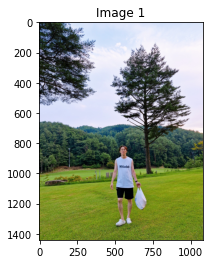

Image 2 shape: (1306, 979, 3)


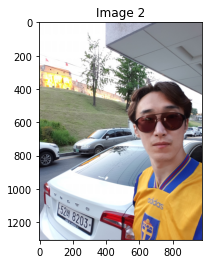

Image 3 shape: (720, 960, 3)


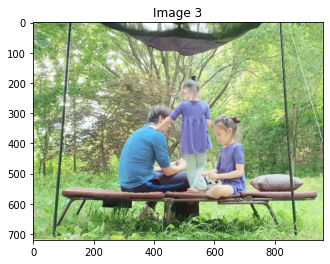

Image 4 shape: (6720, 4480, 3)


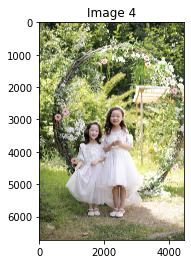

In [8]:
# 각 이미지를 plt.imshow()로 출력하기
for i in range(1, IMAGE_NUM+1):
    img_orig = globals().get(f'img_orig{i}')
    if img_orig is not None:
        print(f'Image {i} shape: {img_orig.shape}')
        plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {i}')  # 이미지에 제목 추가 (옵션)
        plt.show()
    else:
        print(f'Image {i} could not be displayed because it was not loaded properly.')

### for loop 을 이용해서 이미지 4장 한꺼번에 처리 하도록 수정함

In [9]:
# for 문을 사용하여 각 이미지를 읽어오기
images = []
for i, path in enumerate(image_paths):
    img = cv2.imread(path)
    if img is not None:
        images.append(img)
    else:
        print(f'Image {i+1} could not be loaded from path: {path}')

Segmentation map 1 shape: (1440, 1080)


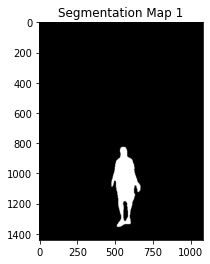

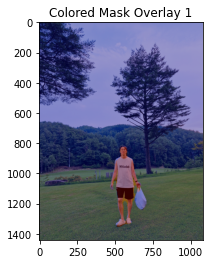

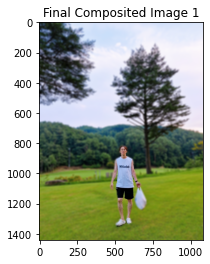

Segmentation map 2 shape: (1306, 979)


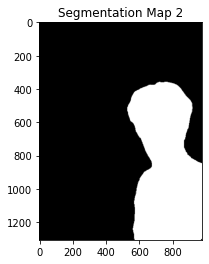

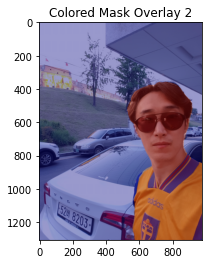

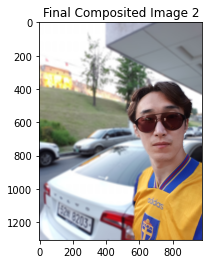

Segmentation map 3 shape: (720, 960)


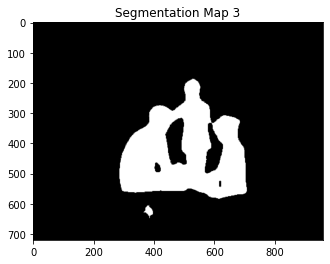

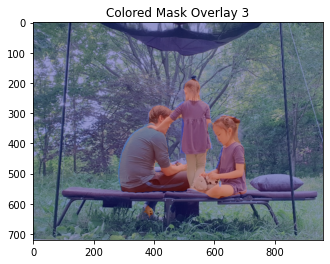

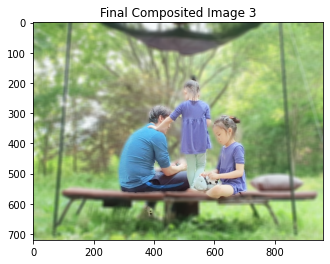

Segmentation map 4 shape: (6720, 4480)


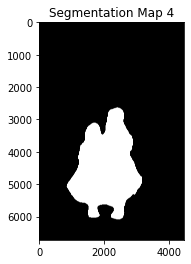

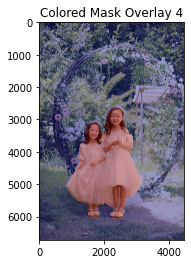

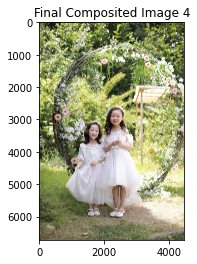

In [10]:
# 각 이미지에 대해 시맨틱 세그멘테이션 수행 및 결과 출력
final_composited_images = []
for i, img_orig in enumerate(images):
    # 모델을 사용하여 이미지 분할 수행
    segvalues, output = model.segmentAsPascalvoc(image_paths[i])

    # 색상 코드 설정 및 세그멘테이션 맵 생성
    # colormap[15] = array([192, 128, 128]) 사람에 해당하는 색상 코드
    seg_color = (128, 128, 192)  # 색상순서 변경 - colormap의 배열은 RGB 순이며 output의 배열은 BGR 순서로 채널 배치가 되어 있어서
    seg_map = np.all(output == seg_color, axis=-1)
    print(f'Segmentation map {i+1} shape: {seg_map.shape}')
    plt.imshow(seg_map, cmap='gray')
    plt.title(f'Segmentation Map {i+1}')
    plt.show()

    # 원본 이미지를 이용하여 사람 위치와 배경을 분리하여 출력
    img_show = img_orig.copy()
    img_mask = seg_map.astype(np.uint8) * 255
    color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)
    img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
    plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
    plt.title(f'Colored Mask Overlay {i+1}')
    plt.show()

    # 배경과 사람 분리 및 합성 이미지 출력
    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
    img_bg_mask = cv2.bitwise_not(img_mask_color)
    img_bg_blur = cv2.bitwise_and(cv2.blur(img_orig, (13, 13)), img_bg_mask)
    img_concat = np.where(img_mask_color == 255, img_orig, img_bg_blur)
    final_composited_images.append(img_concat)
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.title(f'Final Composited Image {i+1}')
    plt.show()

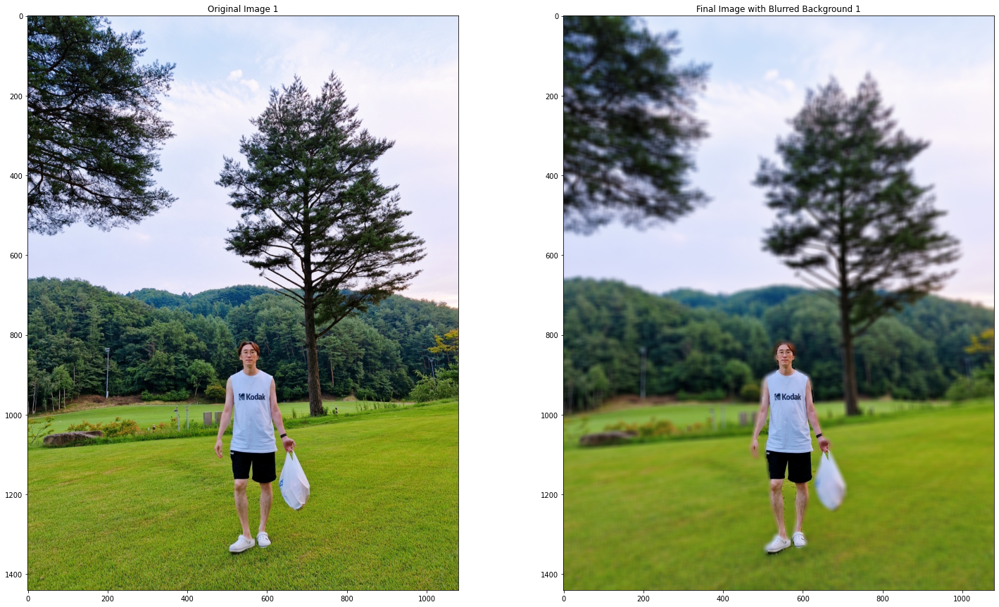

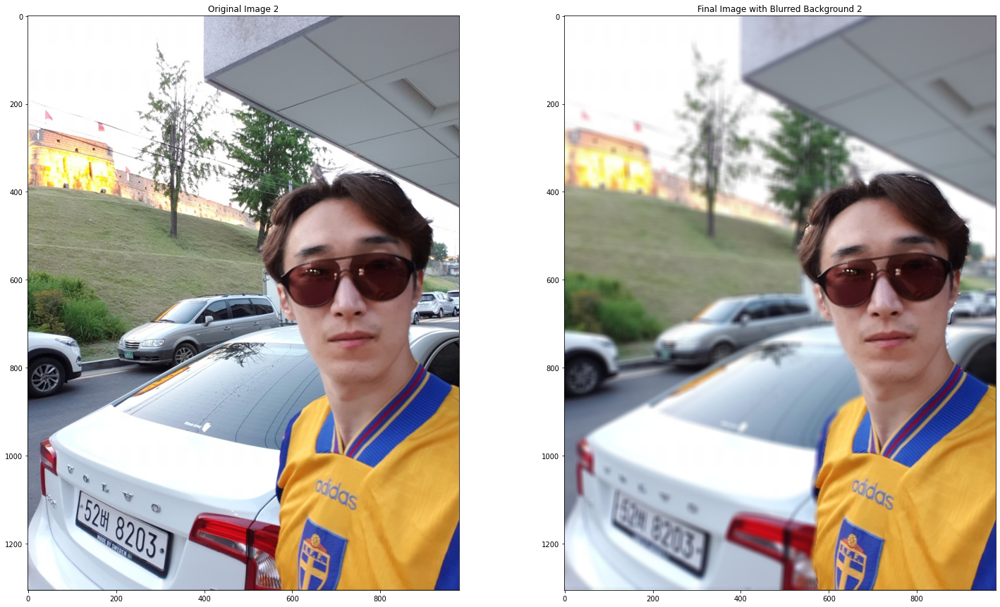

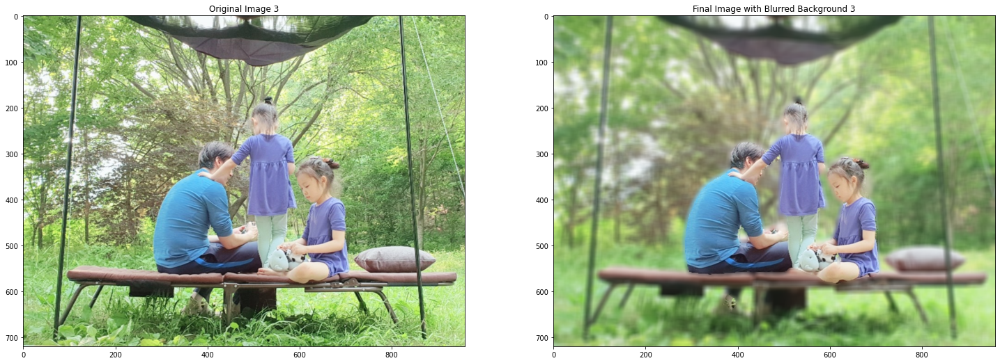

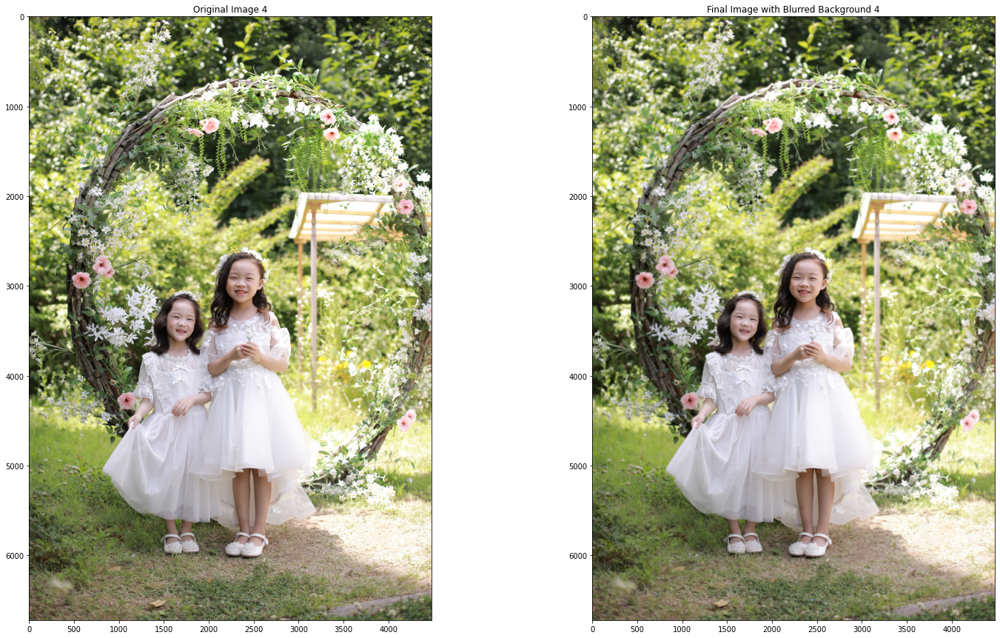

In [11]:
# 원본 이미지와 최종 합성된 이미지 비교 출력
for i, (img_orig, img_concat) in enumerate(zip(images, final_composited_images)):
    plt.figure(figsize=(25, 15))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))
    plt.title(f'Original Image {i+1}')
    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.title(f'Final Image with Blurred Background {i+1}')
    plt.show()

### 완성된 인물 아웃포커싱 사진

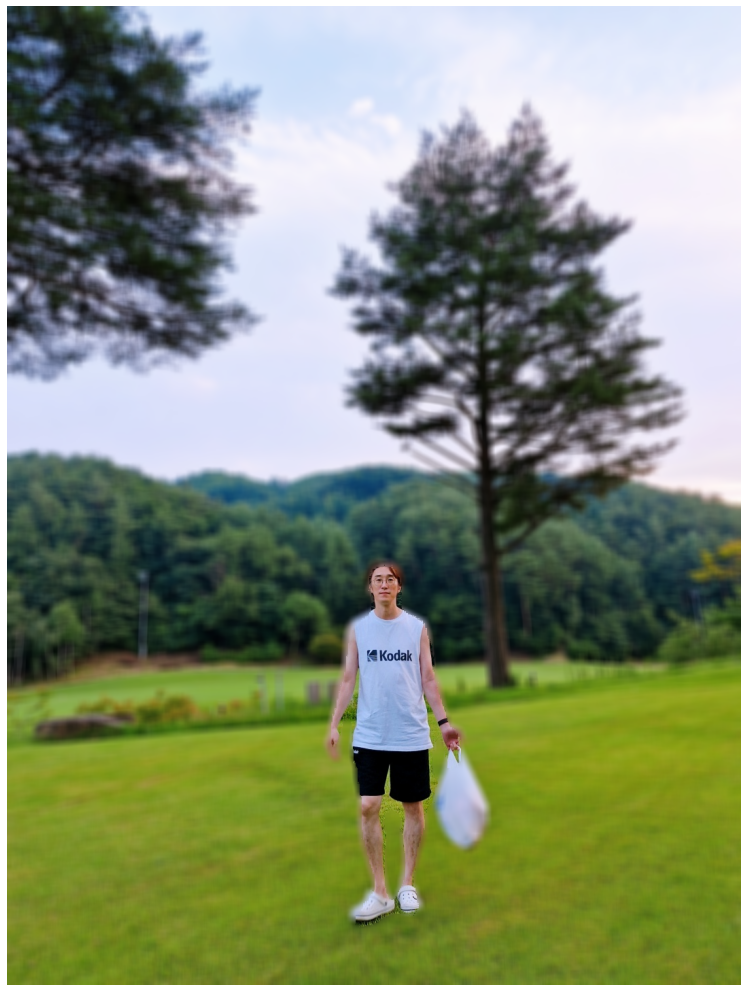

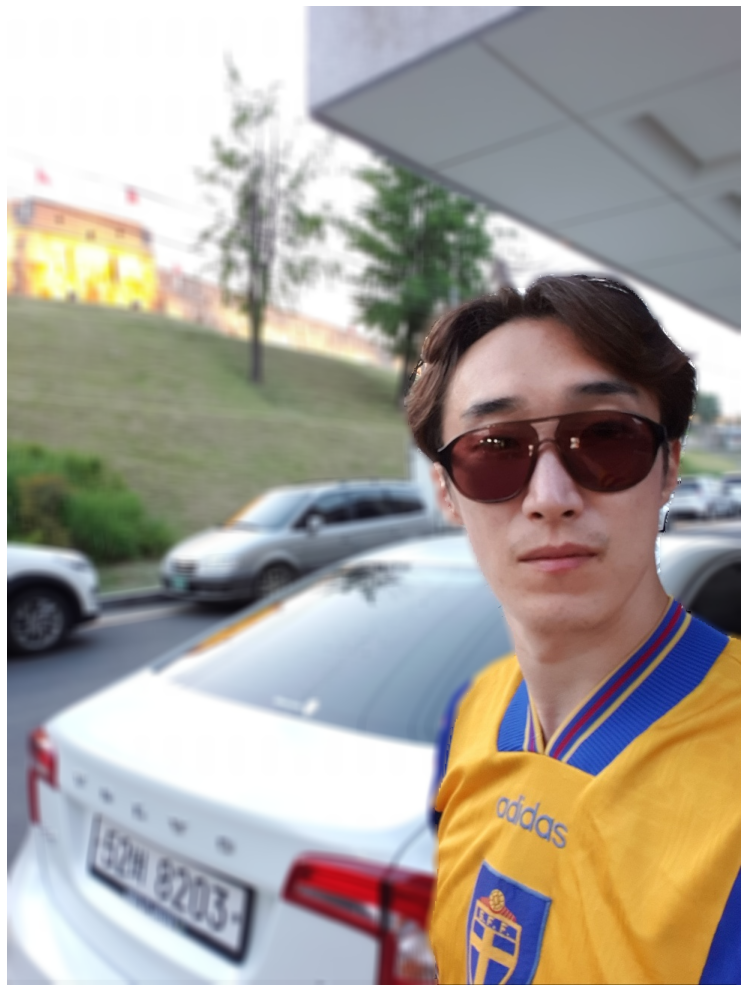

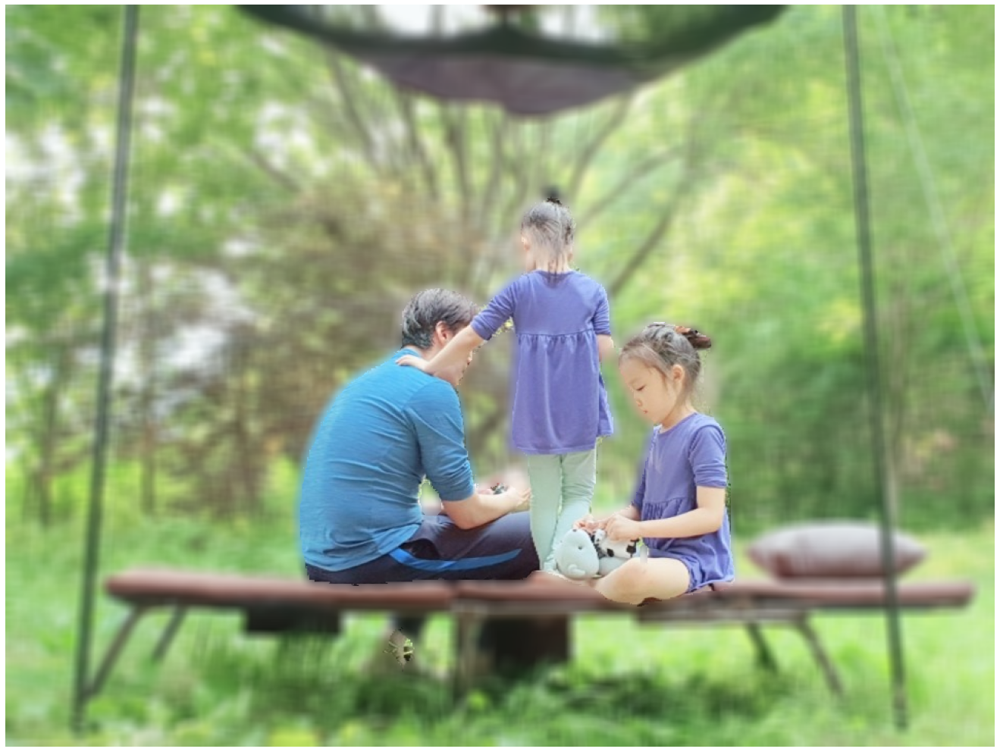

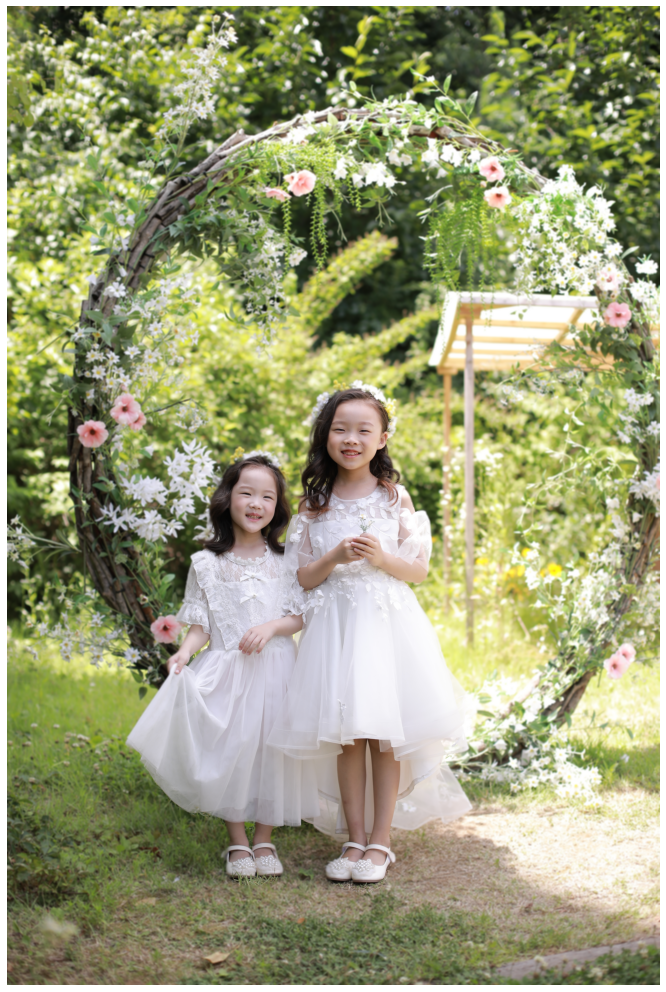

In [12]:
# 최종 합성된 이미지 다시 출력
for i, img_concat in enumerate(final_composited_images):
    plt.figure(figsize=(25, 18))
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.axis('off')  # 좌표값 숨김
    plt.show()

## 고양이 사진 1장 이미지 처리

In [13]:
# my_cat.png 이미지 처리
cat_image_path = os.getenv('HOME') + '/aiffel/human_segmentation/images/my_cat.png'
cat_img_orig = cv2.imread(cat_image_path)

(6720, 4480, 3)


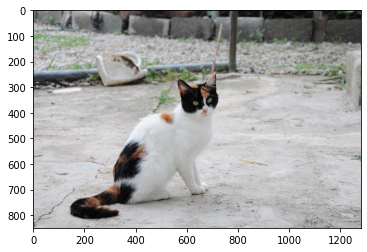

In [14]:
print(img_orig.shape)

# cv2.cvtColor(입력 이미지, 색상 변환 코드): 입력 이미지의 색상 채널을 변경
# cv2.COLOR_BGR2RGB: 이미지 색상 채널을 변경 (BGR 형식을 RGB 형식으로 변경)
# plt.imshow(): 저장된 데이터를 이미지의 형식으로 표시, 입력은 RGB(A) 데이터 혹은 2D 스칼라 데이터
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.imshow.html
# plt.show(): 현재 열려있는 모든 figure를 표시 (여기서 figure는 이미지, 그래프 등)
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.show.html
plt.imshow(cv2.cvtColor(cat_img_orig, cv2.COLOR_BGR2RGB))
plt.show()

In [15]:
# 모델을 사용하여 이미지 분할 수행
segvalues, output = model.segmentAsPascalvoc(cat_image_path)

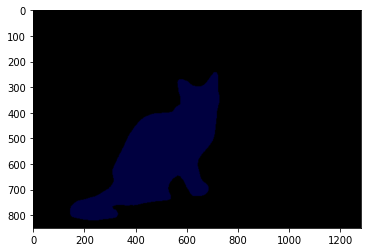

In [16]:
#segmentAsPascalvoc() 함수 를 호출하여 입력된 이미지를 분할한 뒤 나온 결과값 중 output을 matplotlib을 이용해 출력
plt.imshow(output)
plt.show()

In [17]:
segvalues # segmentAsPascalvoc() 함수를 호출하여 입력된 이미지를 분할한 뒤 나온 결과값 중 배열값을 출력

{'class_ids': array([0, 8]),
 'masks': array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]])}

In [18]:
#pascalvoc 데이터의 라벨종류
LABEL_NAMES = [
    'background', 'aeroplane', 'bicycle', 'bird', 'boat', 'bottle', 'bus',
    'car', 'cat', 'chair', 'cow', 'diningtable', 'dog', 'horse', 'motorbike',
    'person', 'pottedplant', 'sheep', 'sofa', 'train', 'tv'
]
len(LABEL_NAMES)

21

In [19]:
# 아래 코드를 이해하지 않아도 좋습니다
# PixelLib에서 그대로 가져온 코드입니다
# 주목해야 할 것은 생상 코드 결과물이예요!

#컬러맵 만들기 
colormap = np.zeros((256, 3), dtype = int)
ind = np.arange(256, dtype=int)

for shift in reversed(range(8)):
    for channel in range(3):
        colormap[:, channel] |= ((ind >> channel) & 1) << shift
    ind >>= 3

colormap[:20] #생성한 20개의 컬러맵 출력

array([[  0,   0,   0],
       [128,   0,   0],
       [  0, 128,   0],
       [128, 128,   0],
       [  0,   0, 128],
       [128,   0, 128],
       [  0, 128, 128],
       [128, 128, 128],
       [ 64,   0,   0],
       [192,   0,   0],
       [ 64, 128,   0],
       [192, 128,   0],
       [ 64,   0, 128],
       [192,   0, 128],
       [ 64, 128, 128],
       [192, 128, 128],
       [  0,  64,   0],
       [128,  64,   0],
       [  0, 192,   0],
       [128, 192,   0]])

In [20]:
colormap[8] #컬러맵 7에 해당하는 배열 출력 (pacalvoc에 LABEL_NAMES 8번째인 Cat)

array([64,  0,  0])

In [21]:
seg_color = (0,0,64) # 색상순서 변경 - colormap의 배열은 RGB 순이며 output의 배열은 BGR 순서로 채널 배치가 되어 있어서

Cat Segmentation map shape: (850, 1280)


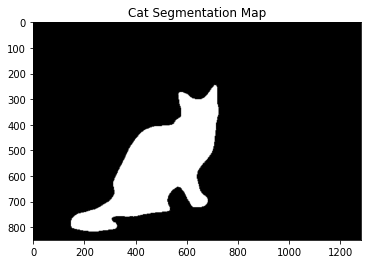

In [22]:
# output의 픽셀 별로 색상이 seg_color와 같다면 1(True), 다르다면 0(False)이 됩니다
# seg_color 값이 person을 값이 므로 사람이 있는 위치를 제외하고는 gray로 출력
# cmap 값을 변경하면 다른 색상으로 확인이 가능함
seg_map = np.all(output == seg_color, axis=-1)
print(f'Cat Segmentation map shape: {seg_map.shape}')
plt.imshow(seg_map, cmap='gray')
plt.title('Cat Segmentation Map')
plt.show()

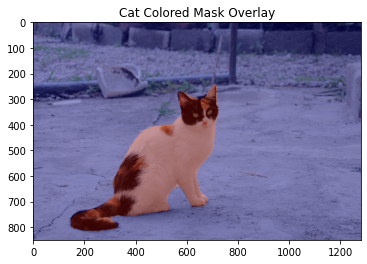

In [23]:
# 원본 이미지를 이용하여 고양이 위치와 배경을 분리하여 출력
img_show = cat_img_orig.copy()
img_mask = seg_map.astype(np.uint8) * 255
color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)
img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
plt.title('Cat Colored Mask Overlay')
plt.show()

### 완성된 고양이 아웃포커싱 사진

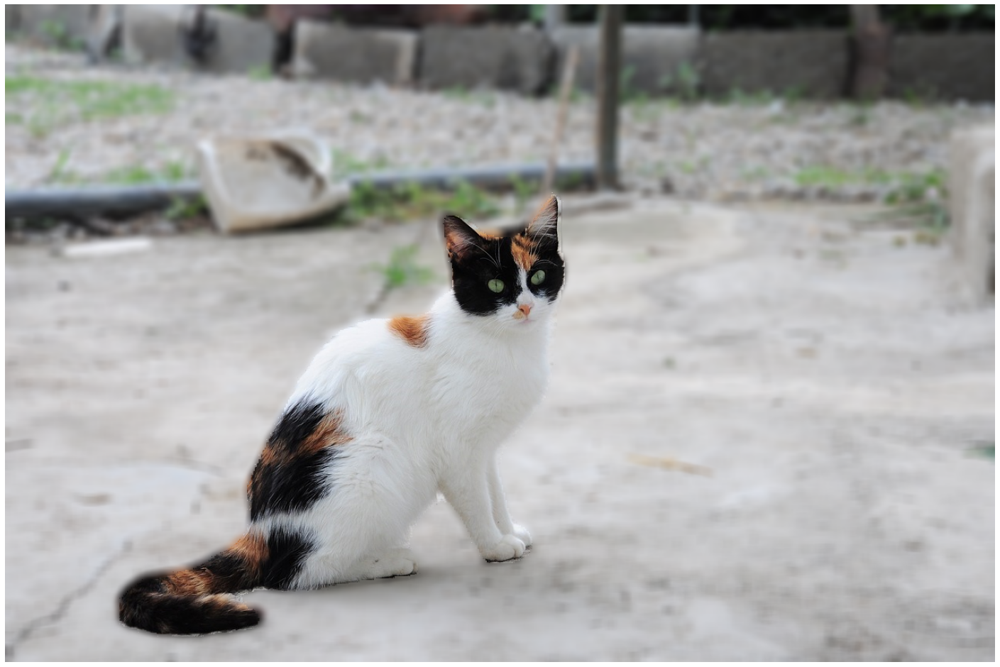

In [24]:
# 배경과 고양이 분리 및 합성 이미지 출력
img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
img_bg_mask = cv2.bitwise_not(img_mask_color)
img_bg_blur = cv2.bitwise_and(cv2.blur(cat_img_orig, (13, 13)), img_bg_mask)
cat_img_concat = np.where(img_mask_color == 255, cat_img_orig, img_bg_blur)
plt.figure(figsize=(25, 18))
plt.imshow(cv2.cvtColor(cat_img_concat, cv2.COLOR_BGR2RGB))
plt.axis('off')  # 좌표값 숨김
plt.show()

## 크로마키 배경 합성

In [25]:
# 크로마키 배경 합성 (사람 인물 사진)
new_background_path = os.getenv('HOME') + '/aiffel/human_segmentation/images/new_background.png'
new_bg_img = cv2.imread(new_background_path)

(1440, 1080, 3)


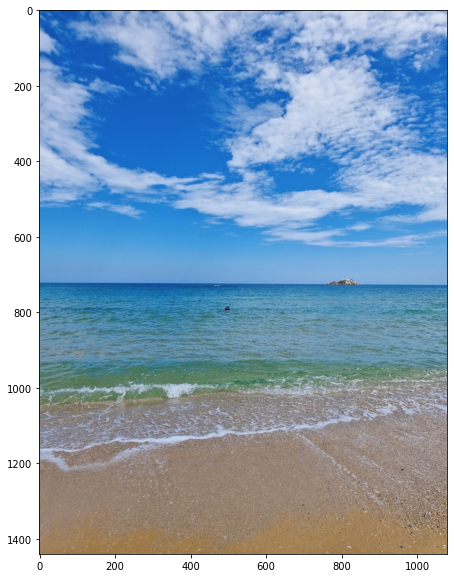

In [26]:
print(new_bg_img.shape)

# cv2.cvtColor(입력 이미지, 색상 변환 코드): 입력 이미지의 색상 채널을 변경
# cv2.COLOR_BGR2RGB: 이미지 색상 채널을 변경 (BGR 형식을 RGB 형식으로 변경)
# plt.imshow(): 저장된 데이터를 이미지의 형식으로 표시, 입력은 RGB(A) 데이터 혹은 2D 스칼라 데이터
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.imshow.html
# plt.show(): 현재 열려있는 모든 figure를 표시 (여기서 figure는 이미지, 그래프 등)
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.show.html
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(new_bg_img, cv2.COLOR_BGR2RGB))
plt.show()

### 크로마키 배경 합성 이미지 출력

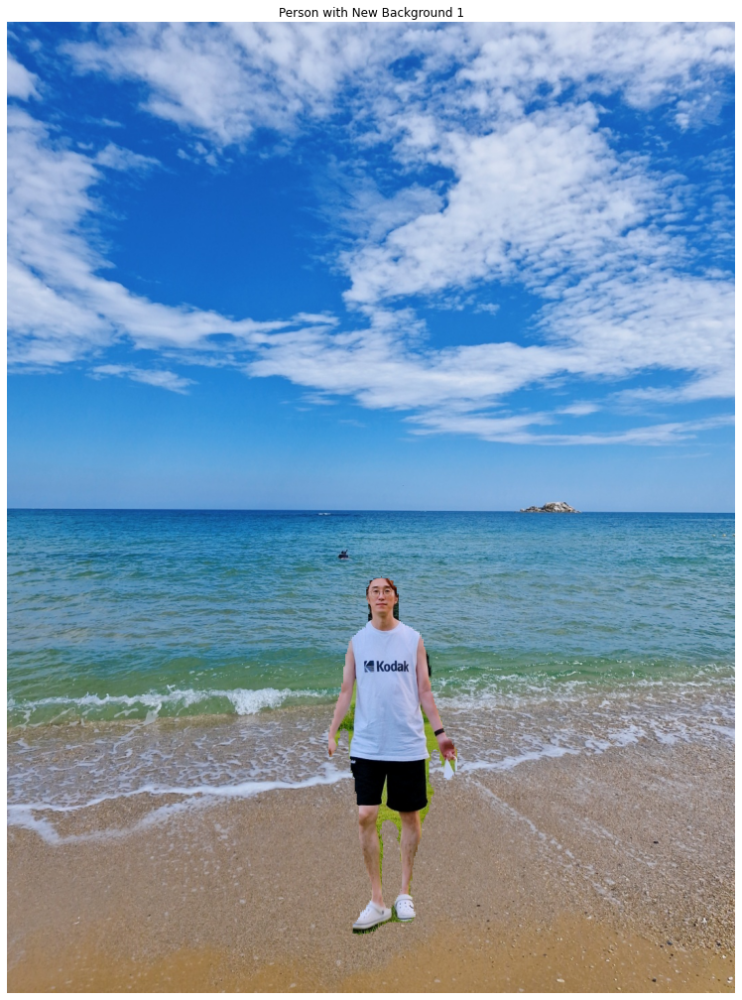

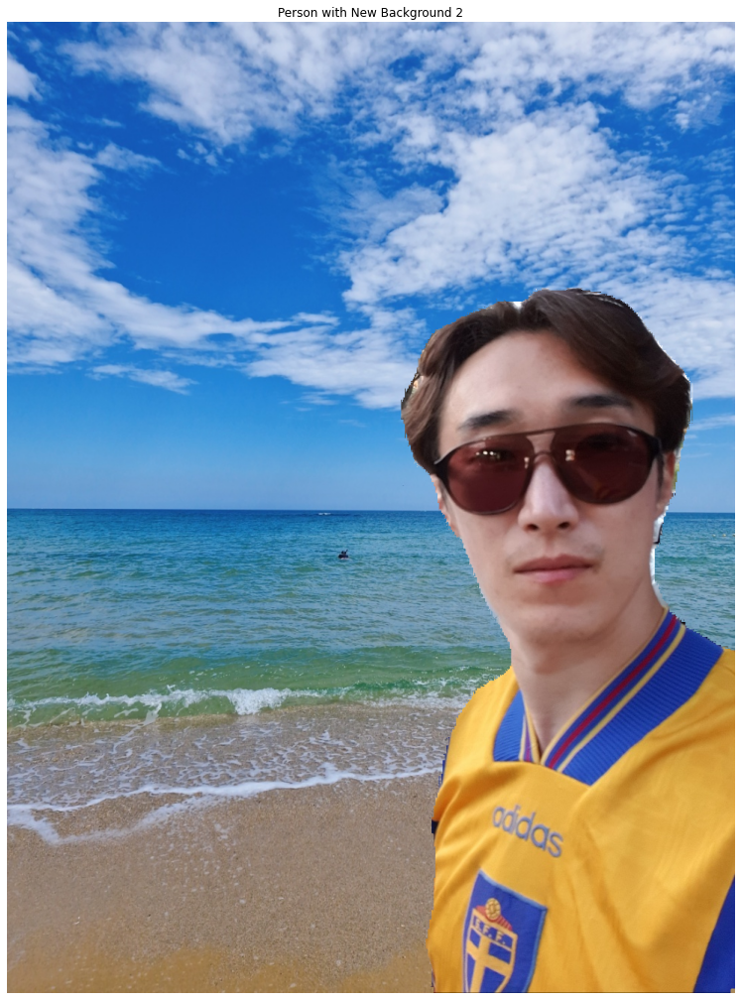

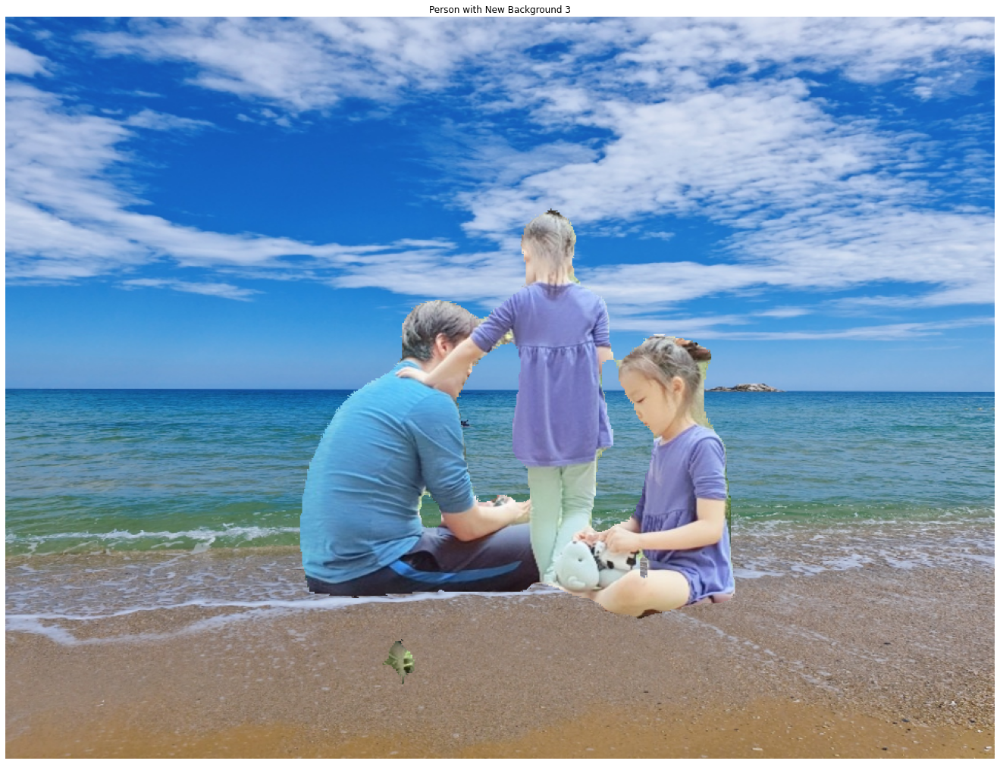

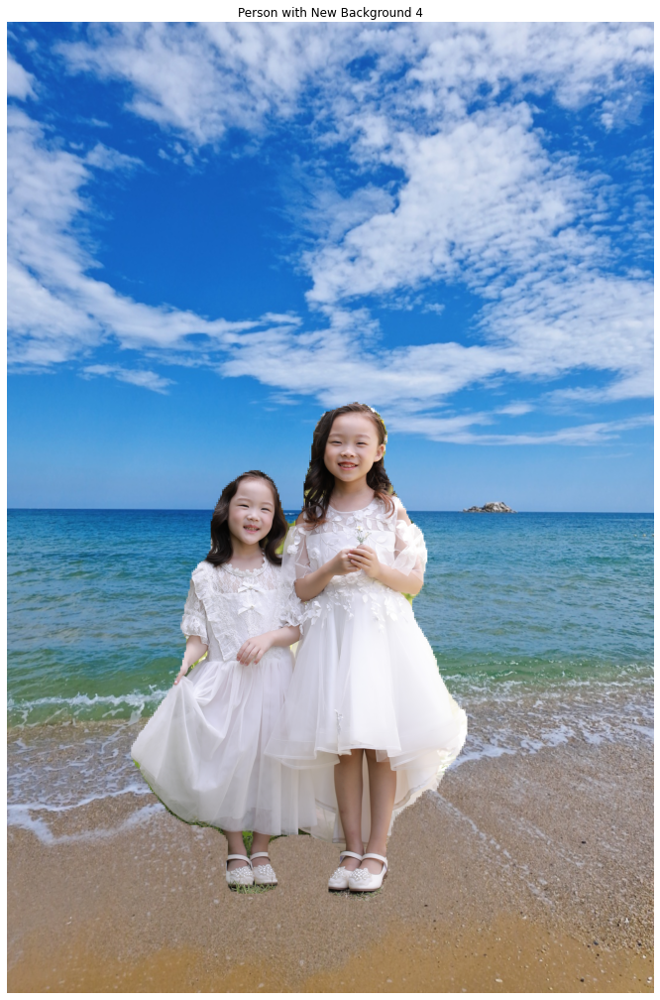

In [27]:
if new_bg_img is not None:
    for i, img_orig in enumerate(images):
        # 모델을 사용하여 이미지 분할 수행
        segvalues, output = model.segmentAsPascalvoc(image_paths[i])
        
        # 색상 코드 설정 및 세그멘테이션 맵 생성
        seg_color = (128, 128, 192)  # 색상순서 변경 - colormap의 배열은 RGB 순이며 output의 배열은 BGR 순서로 채널 배치가 되어 있어서
        seg_map = np.all(output == seg_color, axis=-1)
        img_mask = seg_map.astype(np.uint8) * 255

        # 배경 이미지 크기를 원본 이미지 크기에 맞추기
        new_bg_img_resized = cv2.resize(new_bg_img, (img_orig.shape[1], img_orig.shape[0]))

        # 새로운 배경과 사람 합성 이미지 생성
        img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
        person_img_chromakey = np.where(img_mask_color == 255, img_orig, new_bg_img_resized)
        plt.figure(figsize=(25, 18))
        plt.imshow(cv2.cvtColor(person_img_chromakey, cv2.COLOR_BGR2RGB))
        plt.title(f'Person with New Background {i+1}')
        plt.axis('off')  # 좌표값 숨김
        plt.show()
else:
    print('New background image could not be loaded from path:', new_background_path)

## Step 2. 사진에서 문제점 찾기
---
그러나 여러분들의 사진에는 무언가 문제점이 있을 것입니다.

아래 사진에도 문제점이 몇 가지 있었습니다. 예를 들어 뒤에 걸린 옷이 인물 영역에 포함되어 blur되지 않고 나온다던가 하는 경우입니다. ㅠㅠ 그 외 다른 문제들이 눈에 띄시나요? 아래 사진에는 이상한 점이 최소 2개 이상 더 있습니다. 어떤 문제가 있는지 찾아서 아래 사진처럼 표시해 봅시다.

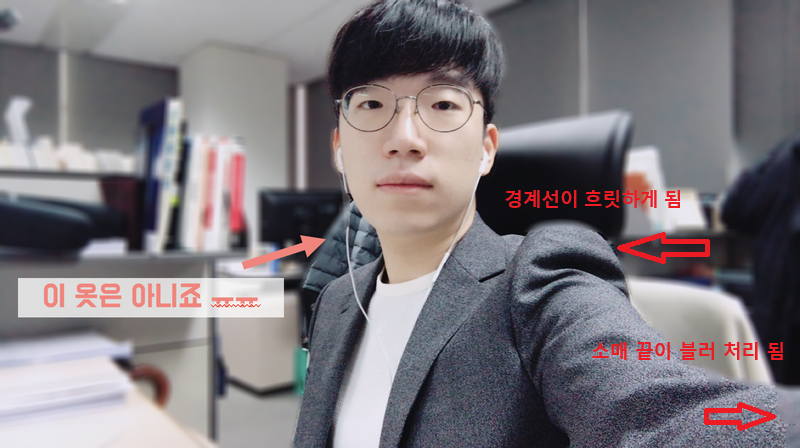

추가로 여러분이 만들어 낸 인물 모드 사진 중 하나에서도 이상한 위치를 찾아 아래 사진처럼 표시해 봅시다. 표시한 이미지들을 jupyter notebook에 포함하여 제출해 주세요.

## 문제점 1 : 주로 사람과 배경의 경계선에서 문제가 많이 나타나거나 팔과 몸의 사이에 있는 배경 등에서 블러 처리가 잘 안되는 문제가 발생하고 있습니다.

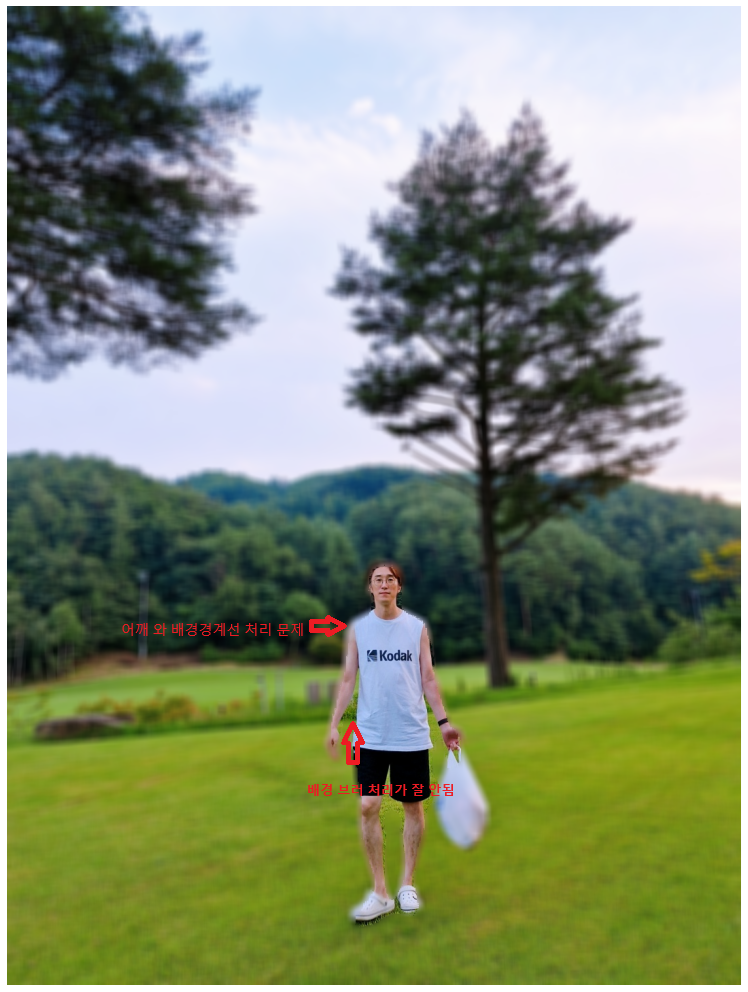

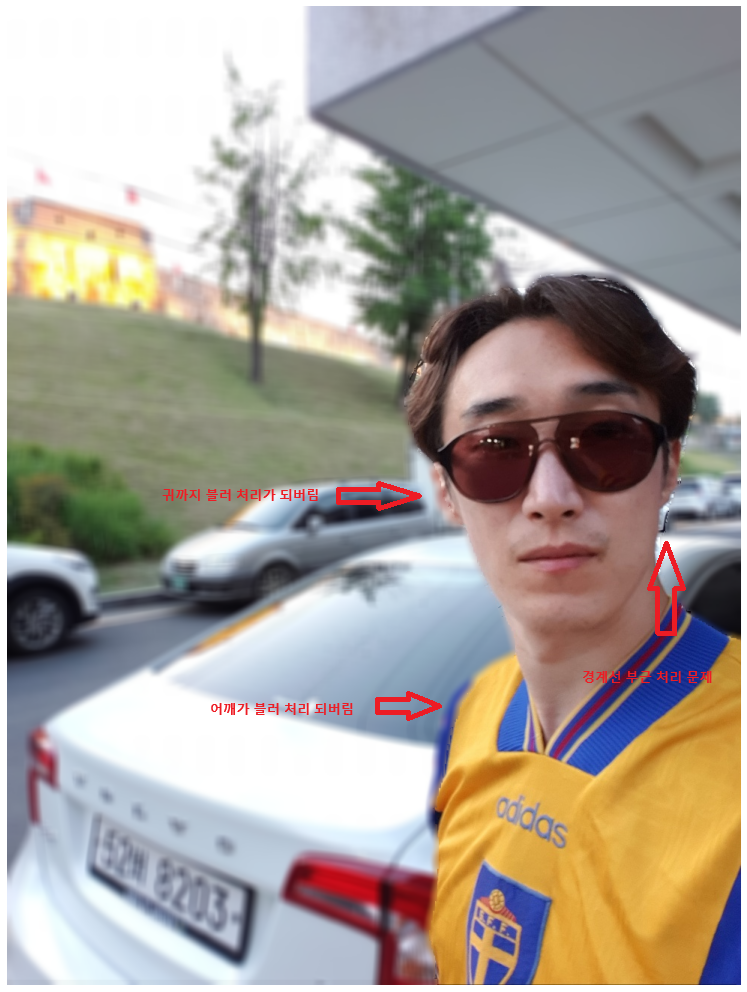

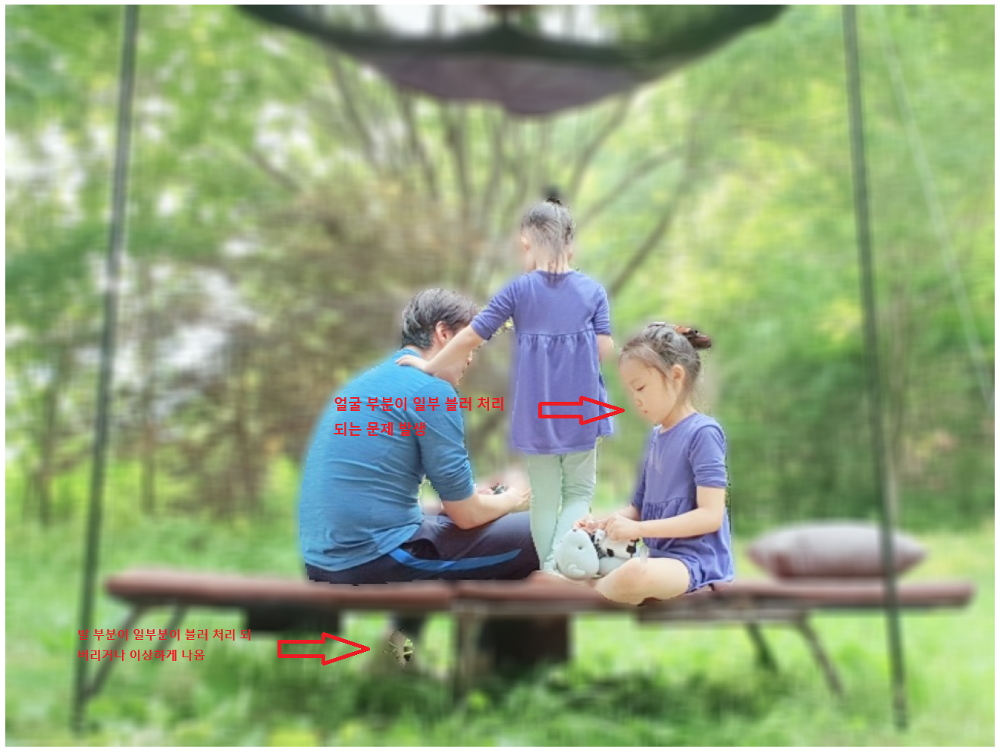

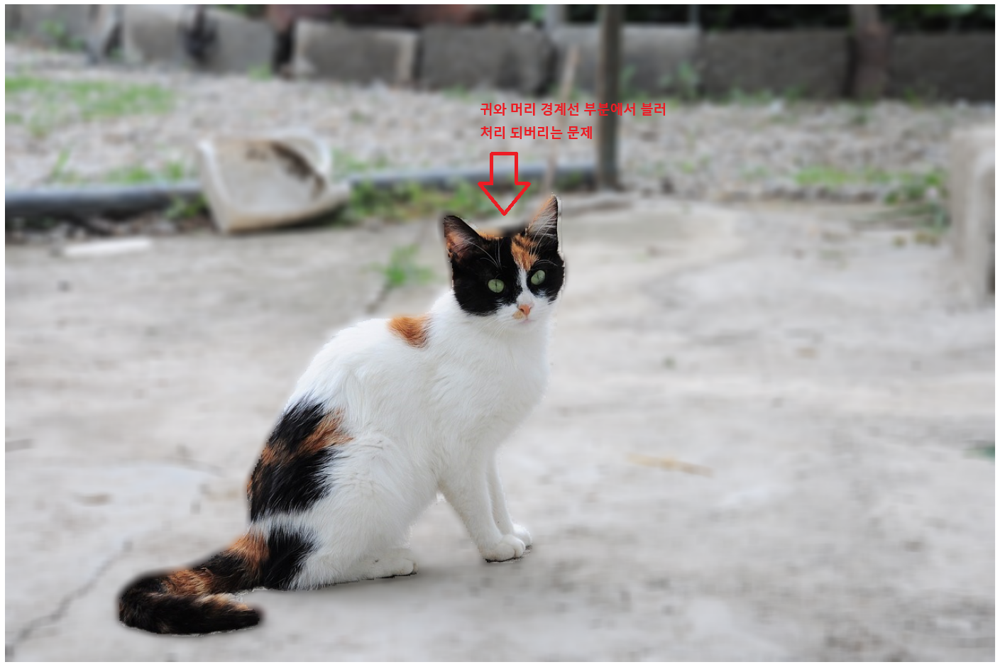

## 문제점2 : 고화질 사진(48.7MB, 4480 x 6720)은 배경 화면이 블러 처리가 안되는(?) 현상 발생

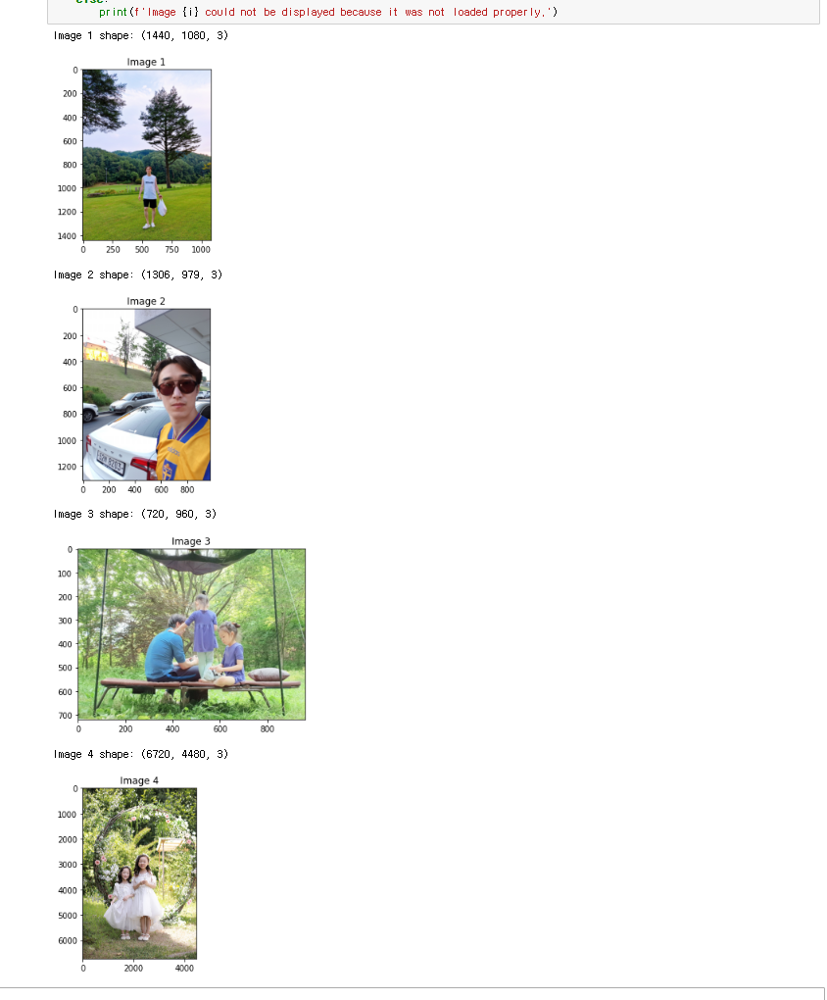

## 사림이 2명 있는 고화질 사진(48.7MB, 4480 x 6720)은 원본과 차이가 안남
- img_bg_blur = cv2.bitwise_and(cv2.blur(cat_img, (13, 13)), img_bg_mask) 에서 커널 13 조정이 필요 할 듯

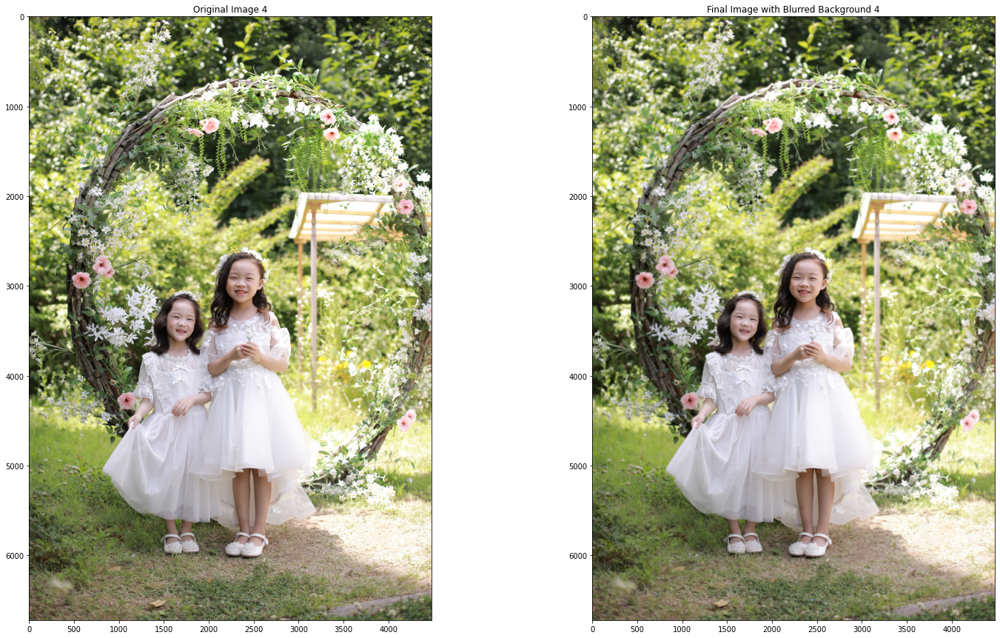

In [28]:
plt.figure(figsize=(25, 15))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img_orig4, cv2.COLOR_BGR2RGB))
plt.title(f'Original Image 4')
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(final_composited_images[3], cv2.COLOR_BGR2RGB))
plt.title(f'Final Image with Blurred Background 4')
plt.show()

## Step 3. 해결 방법을 제안해 보기
---
아주 간단히 멋진 카메라 앱 서비스를 만들어 출시할 수 있을 것 같았지만, 지금 같은 완성도로는 어림도 없습니다. 소비자들의 눈높이는 그리 호락호락하지 않고, 엔지니어인 여러분들은 답을 찾아내야 합니다.

생각해 볼 만한 주제를 아래에 몇 가지 제시해 봅니다. 아래를 읽어본 후, 여러분이 만든 인물모드 사진의 문제점을 해결할 방안을 정리하여 제안해 주시기 바랍니다.
단순히 'XXX 기술을 사용한다.' 정도의 선언적 솔루션이 아니라, 여러분들이 선택한 기술이 DeepLab 모델의 Semantic Segmentation 이 만들어 낸 Mask 영역에 어떻게 적용되어 문제점을 보완하게 되는지의 메커니즘이 포함된 솔루션이어야 합니다.

세그멘테이션의 한계  

Semantic segmentation의 부정확성이 여러 가지 문제를 발생시키는 주요 원인입니다. 피사계심도를 이용한 보케(아웃포커싱) 효과는 말 그대로 심도를 표현하기 때문에 초점이 잡힌 거리를 광학적으로 아주 섬세하게 구별(segmentation) 하지만 이를 따라 한 semantic segmentation 모듈은 정확도가 1.00 이 되지 않는 한 완벽히 구현하기는 힘듭니다.

피사계 심도 이해하기  

우선 피사계심도의 개념부터 명확히 이해해 봅시다.

- 아웃포커싱 하는 법 : https://m.blog.naver.com/typs6301/222172333739
- 얕은 피사계 심도 촬영의 이해 : https://www.adobe.com/kr/creativecloud/photography/discover/shallow-depth-of-field.html

3D Camera 활용하기  

이미지를 2D 방식으로 받아들이는 한계를 넘어 3D로 인식하려는 시도는 꽤 오래전부터 계속되어 왔습니다. 기술도 이제는 상당한 수준에 이르렀는데요. 크게는 스테레오 비전, ToF 방식 등이 자주 사용됩니다. 하드웨어 이미지 센서를 통한 3D 이미징 기술이 많이 발전되었는데요. 아래 참고 자료를 통해 최신 기술을 살펴봐도 좋습니다.

- 3D 이미지센서 : https://news.skhynix.co.kr/post/next-gen-3d

소프트웨어 기술 활용하기  

하드웨어 개발과 생산에는 비용이 많이 들기 때문에 제한된 하드웨어를 이용하면서 소프트웨어로 그 한계를 극복하려는 노력도 많습니다. 구글의 struct2Depth가 대표적인 예일 것 같습니다.

Unsupervised Learning of Depth and Ego-Motion: A Structured Approach
https://sites.google.com/view/struct2depth

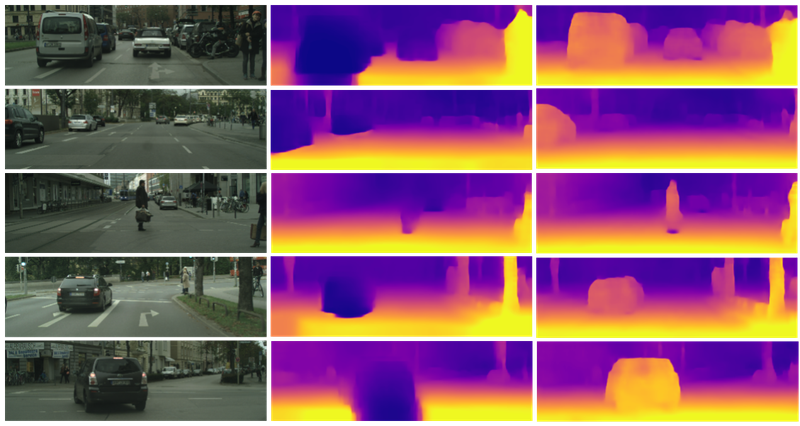

딥러닝이 발전한 지금은 더 다양한 기술이 개발되어 있으니 잘 탐색해 보세요.  


다른 기술과 융합해 보기  

구글 pixel4에는 IR(적외선) 카메라가 달려있는데요. 물체의 온도를 측정하는 IR 카메라와 3D 이미지는 크게 관련이 없을 것 같지만, 이를 통해 보다 멋진 3d depth sensing이 가능하다는군요.

uDepth: Real-time 3D Depth Sensing on the Pixel 4
https://research.google/blog/udepth-real-time-3d-depth-sensing-on-the-pixel-4/

이렇게 카메라와 무관한 다른 기술과 융합하는 것도 좋은 해결책이 될 수 있습니다. 한 번 고민해 보세요!

이 외에도 다른 방식으로 접근해도 좋습니다. 엔지니어로서 본인이 선택한 솔루션을 잘 설명해 주세요. 가능하다면 순서도(Flow Chart)를 활용하면 좋습니다. 멋진 아이디어를 기대하겠습니다!!

## 해결 방법들 정리

1. 문제점: 세그멘테이션의 부정확성  
현재 사용된 DeepLab 모델의 Semantic Segmentation은 픽셀 단위로 객체를 구분하는 과정에서 정확도가 완벽하지 않습니다. 특히 인물의 경계 부분에서 배경과의 혼합이 발생하거나 작은 세부 요소(예: 머리카락, 손가락 끝 부분 등)가 정확히 분리되지 않는 경우가 많습니다. 이로 인해 보케(아웃포커싱) 효과를 줄 때 경계가 흐리거나 부자연스러운 결과가 나옵니다.
---
2. 개선 방안: 다단계 마스크 정제 및 깊이 예측 모델의 사용  
    2.1. CRF(Conditional Random Field)를 이용한 마스크 정제
    DeepLab 모델에서 생성된 초기 마스크는 객체와 배경 간의 구분이 완벽하지 않기 때문에, 후처리 단계로 CRF(Conditional Random Field) 를 사용해 마스크를 정제합니다.  

    CRF는 픽셀 간의 관계를 고려하여 인접한 픽셀들이 같은 클래스에 속할 가능성을 높이도록 마스크를 개선합니다. 이를 통해 객체의 경계를 더 정확하게 잡아줍니다.  

    메커니즘: CRF는 이미지의 RGB 값, 위치, 그리고 주변 픽셀들과의 유사성을 이용해 픽셀의 레이블을 재조정합니다. 이렇게 함으로써 마스크의 경계 부분이 더 부드럽고 정확해집니다. 예를 들어, 머리카락과 배경의 경계가 흐릿한 부분에서도, CRF가 이 경계를 더 잘 구분하여 세밀한 마스크를 생성할 수 있습니다.  

    2.2. Depth Estimation 모델 도입  
    심도 표현의 한계를 극복하기 위해 Monocular Depth Estimation 모델을 추가적으로 활용합니다. 이 모델은 단일 이미지로부터 각 픽셀의 깊이 값을 추정합니다.  
    메커니즘: 심도 추정 모델은 이미지의 각 픽셀에 대해 거리를 예측하여, 인물과 배경 사이의 거리를 정확히 구분해 줍니다. 이 예측된 심도 값을 기반으로 배경 블러의 강도를 달리하여 점진적인 아웃포커싱 효과를 적용할 수 있습니다.  
    적용 방식: 추정된 깊이 값을 Gaussian Blur와 결합하여, 거리에 따라 블러 강도를 다르게 설정합니다. 예를 들어, 인물에서 멀어질수록 블러 강도를 점차적으로 높여주어 실제 렌즈에서 발생하는 보케 효과를 시뮬레이션합니다.  

    2.3. 경계 강화 및 자연스러운 블렌딩  
    인물과 배경 사이의 경계 강화를 위해 경계 강화 필터(edge refinement filter)를 사용합니다.  
    메커니즘: 경계 영역에서 두 개의 마스크를 결합하여 경계선 주변을 매끄럽게 만들어 줍니다. 이는 인물의 경계와 배경의 블러 처리된 영역 간의 부자연스러운 전환을 개선합니다.  
    Alpha Blending을 이용해 경계 부분을 자연스럽게 연결합니다. 마스크 경계의 알파 값을 점차적으로 변화시켜 인물과 배경의 경계가 부드럽게 전환되도록 합니다.  
---
3. 기술 적용 요약  
CRF 후처리를 통해 DeepLab에서 생성된 마스크의 정확성을 개선하여 경계를 더 선명하게 만듭니다.
Monocular Depth Estimation을 사용해 각 픽셀의 심도를 추정하고, 이를 바탕으로 깊이별로 다른 강도의 블러를 적용해 실제 렌즈의 심도 효과와 유사하게 만듭니다.
경계 강화 필터와 Alpha Blending을 통해 인물과 배경의 경계를 자연스럽게 연결하여, 더 완벽하고 시각적으로 매끄러운 결과를 얻을 수 있습니다.
이러한 개선 방안들을 통해 Semantic Segmentation 기반 인물모드의 한계를 극복하고, 실제 렌즈의 보케 효과와 유사한 자연스러운 사진을 얻을 수 있습니다. 이를 통해 소비자들의 높은 눈높이를 충족시키고, 완성도 높은 카메라 앱 서비스를 제공할 수 있을 것입니다.

## 시맨틱 세그멘테이션 모델

1. DeepLabV3+  
특징: Google에서 개발한 고성능 시맨틱 세그멘테이션 모델로, DeepLabV3를 개선하여 디코더를 추가함으로써 경계선의 세밀한 표현을 가능하게 합니다.
장점: 엔코더-디코더 구조로 복잡한 경계를 잘 표현합니다. Atrous Convolution을 사용하여 전역 맥락 정보를 캡처하는 데 효과적입니다.
활용: 현재 코드에서도 사용되고 있으며, 사람이나 물체의 경계선이 복잡한 경우 좋은 성능을 보입니다.  

2. Mask R-CNN  
특징: Region Proposal Network(RPN)를 사용하여 객체를 탐지하고, 픽셀 단위로 마스크를 생성합니다. 객체 검출과 세그멘테이션을 동시에 수행할 수 있습니다.
장점: 객체의 개별 마스크를 생성하기 때문에 여러 객체가 있는 복잡한 이미지에서도 뛰어난 성능을 발휘합니다.
활용: 인스턴스 세그멘테이션에 적합하며, 객체의 위치와 마스크를 모두 얻고자 할 때 사용됩니다.  

3. U-Net  
특징: U 모양의 대칭적인 네트워크 구조로 의료 이미지 처리에서 처음 도입되었습니다. 인코딩 및 디코딩 경로를 통해 이미지 세부 정보를 보존합니다.
장점: 상대적으로 간단한 구조로 높은 성능을 보이며, 데이터가 적을 때도 학습 성능이 뛰어납니다.
활용: 의료 영상이나 간단한 객체 구분 작업에 적합합니다. 작은 데이터셋에서도 잘 작동합니다.  

4. HRNet (High-Resolution Network)  
특징: 인코딩 중에도 고해상도 특징 맵을 유지하는 모델로, 고해상도의 이미지에서 복잡한 물체의 세그멘테이션 성능이 뛰어납니다.
장점: 고해상도의 이미지에서도 성능 저하 없이 세밀한 세그멘테이션이 가능합니다.
활용: 고해상도에서의 세그멘테이션 작업이나 복잡한 이미지 처리에 적합합니다.  

5. SegFormer  
특징: 트랜스포머를 활용한 최신 시맨틱 세그멘테이션 모델로, CNN의 한계를 넘어 더 나은 전역 정보를 포착합니다.
장점: 트랜스포머의 장점을 활용하여 긴 리셉티브 필드를 효과적으로 처리할 수 있으며, 더 가벼운 모델 구조로 높은 성능을 발휘합니다.
활용: 도시 장면이나 복잡한 물체가 많이 포함된 장면의 세그멘테이션에서 뛰어난 성능을 발휘합니다.  

6. PSPNet (Pyramid Scene Parsing Network)  
특징: Pyramid Pooling Module을 사용하여 다양한 크기의 맥락 정보를 결합하여 장면의 의미를 포착하는 데 효과적입니다.
장점: 전역 및 지역 맥락을 결합하여 세밀한 세그멘테이션을 제공합니다.
활용: 복잡한 장면의 시맨틱 세그멘테이션에 적합하며, 다양한 크기의 객체가 있는 경우 좋은 성능을 보입니다.  

이들 중에서, 어떤 모델이 가장 적합한지는 문제의 특성, 이미지의 복잡도, 경계의 세밀도 필요성 등에 따라 다릅니다. 예를 들어, 인스턴스 별로 객체를 구분하고 싶다면 Mask R-CNN이 적합하고, 경계가 복잡한 인물 사진에서는 DeepLabV3 나 HRNet이 좋은 선택입니다. SegFormer는 최신 트랜스포머 기반 세그멘테이션으로, 높은 성능과 경량화를 동시에 제공합니다.

## 회고
---

- 세그멘테이션을 직접 해 볼 수 있어서 재미있었다.
- 사진 4장을 한번에 처리하는 로직에서 좀 해매는 바람에 아래 부분 테스트 해 볼 시간이 좀 부족해서 아쉬웠다.
- 고화질 사진(48.7MB, 4480 x 6720) 에서 배경 블러 처리 효과가 없었던 부분에 대해 커널 사이즈 조정 하는 테스트를 진행 해 볼 예정이다.
- 아래 DeepLabV3+ 사용해서 개선이 가능한지 테스트 진행 해 볼 예정이다.
- 그 외 Mask R-CNN 이나 SegFormer 모델도 더 알아 보면서 진행 하려고 한다.

# DeepLabV3+ 사용
---
**DeepLabV3+**는 Google에서 개발한 고성능 시맨틱 세그멘테이션 모델입니다. 기존 DeepLabV3 모델을 개선하여 경계선에서의 세밀도를 높이고, 스키핑 연결을 통해 상세한 정보를 효과적으로 보존할 수 있도록 설계되었습니다. TensorFlow Hub를 통해 간단히 불러와 사용할 수 있으며, 이미지 내에서 각 클래스의 픽셀을 분할하는 데 뛰어난 성능을 제공합니다.

주요 특징
- Encoder-Decoder 구조: DeepLabV3+는 엔코더-디코더 구조를 사용하여 세그멘테이션의 정확도를 높입니다. 
- 엔코더는 특징을 추출하고 디코더는 이 특징을 사용해 픽셀 단위로 정교하게 복원합니다.
- Atrous Convolution (팽창 합성곱): 이미지의 전역 맥락 정보를 잘 유지하기 위해 팽창 합성곱을 사용합니다. 이를 통해 계산량의 증가 없이 큰 리셉티브 필드를 얻을 수 있습니다.
- 경계선 세밀화: 경계선 근처의 객체 구분이 더욱 향상되어, 특히 사람, 사물 등의 복잡한 경계를 가진 이미지에서도 더 나은 성능을 제공합니다.

## DeepLabV3+ 와 DeepLabV3 차이점

1. 구조적 차이: 디코더 모듈 추가
DeepLabV3는 엔코더만 있는 구조로, 팽창 합성곱(Atrous Convolution)을 사용해 전역적인 맥락 정보를 얻는 데 중점을 두었습니다.
**DeepLabV3+**는 디코더 모듈을 추가하여 세그멘테이션의 정확도를 높였습니다. 이 디코더 모듈은 이미지의 경계 부분을 더 정확하게 세분화하여 세밀한 물체의 구분이 가능합니다. 특히, 디테일이 중요한 경계 부분에서 세그멘테이션 성능이 더 뛰어납니다.

2. 경계 검출 성능 향상
DeepLabV3는 팽창 합성곱을 통해 리셉티브 필드를 늘림으로써 전역적인 정보를 잘 캡처했지만, 경계 근처의 세밀한 세그멘테이션 성능은 상대적으로 부족했습니다.
DeepLabV3+는 디코더를 사용하여 경계 정보를 보존하고, 세그멘테이션이 경계 근처에서도 더 자연스럽게 작동하도록 개선되었습니다. 이를 통해 사람의 머리카락, 손끝 등 복잡한 부분을 더욱 정확히 처리할 수 있습니다.

3. 추가적인 스키핑 연결
DeepLabV3+는 고해상도 특징 맵을 보존하기 위해 **스키핑 연결(skip connection)**을 사용하여 이미지의 해상도를 복원하고, 디코더에서 세밀한 정보를 잘 유지할 수 있도록 합니다.
이러한 스키핑 연결은 저해상도 특징 맵과 고해상도 정보를 결합하여 최종 세그멘테이션 맵의 세밀도를 높입니다.

4. 활용 용도 및 장점
DeepLabV3는 간단하고 빠르며, 전역 맥락을 포착하는 데 적합하기 때문에 효율성이 높은 환경에서 유용합니다.
**DeepLabV3+**는 고해상도 이미지에서 복잡한 객체를 정확히 구분해야 하는 경우나 경계가 중요한 응용에서 특히 뛰어납니다. 경계 근처의 객체 구분을 개선함으로써, 복잡한 장면에서도 더욱 정밀한 결과를 제공합니다.

5. 사용 시 차이점
모델 구조: DeepLabV3는 엔코더만 있지만, DeepLabV3+는 엔코더와 디코더가 모두 포함되어 있습니다.
세그멘테이션 결과: DeepLabV3+의 경우 경계 검출이 더 정밀하여 복잡한 경계 영역에서도 더 나은 성능을 발휘합니다.
실행 시간: 디코더 모듈이 추가됨으로써 DeepLabV3+는 DeepLabV3보다 약간 더 많은 계산 자원이 필요할 수 있지만, 그만큼 정확도가 높아집니다.

6. 코드 적용 방식
현재 코드에서는 TensorFlow Hub를 통해 DeepLabV3+를 로드하여 이미지를 세그멘테이션하고 있습니다. DeepLabV3+의 디코더 모듈 덕분에 경계가 더 선명하게 분할되며, 이를 이용해 사람 부분과 배경을 정확히 분리하고, 배경을 블러 처리하거나 다른 배경으로 교체하는 작업을 수행할 수 있습니다.

DeepLabV3와의 차이점으로 인해, 동일한 데이터에서 DeepLabV3+가 더 나은 세그멘테이션 결과를 도출할 것입니다.
특히 경계 부근의 복잡한 영역에서 DeepLabV3+가 DeepLabV3보다 더 정밀하게 구분할 수 있습니다.

## 피어 리뷰 후 추가 작성

### 커널 사이즈를 동적으로 계산 추가
---
1. 이미지의 크기에 따라 커널 크기를 설정합니다.
- 코드에서는 이미지의 높이(img_orig.shape[0])와 너비(img_orig.shape[1]) 중 더 작은 값을 사용하여 커널 크기를 결정합니다.
- min(img_orig.shape[0], img_orig.shape[1]) / 30을 사용하여 이미지 크기에 비례하는 커널 크기를 동적으로 계산합니다.

2. 기본 커널 크기 설정:
- 커널 크기는 최소 15 이상이 되도록 설정되어 있습니다 (max(15, ...))

3. 커널 크기는 홀수
- 블러링을 위해 사용하는 커널 크기는 홀수여야 하기 때문에 계산된 커널 크기가 짝수일 경우, 1을 추가하여 홀수로 만들어 줍니다 (if kernel_size % 2 == 0: kernel_size += 1).

Segmentation map 1 shape: (1440, 1080)


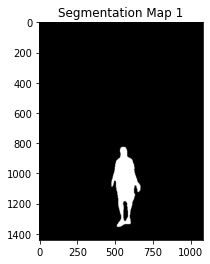

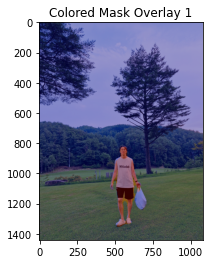

Image 1 uses kernel size: (37, 37)


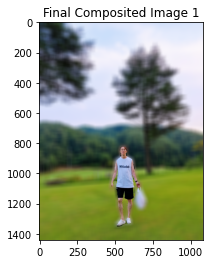

Segmentation map 2 shape: (1306, 979)


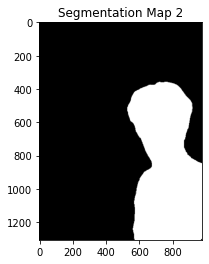

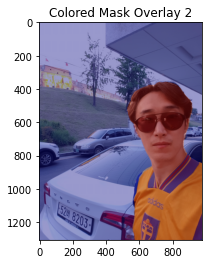

Image 2 uses kernel size: (33, 33)


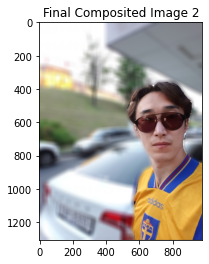

Segmentation map 3 shape: (720, 960)


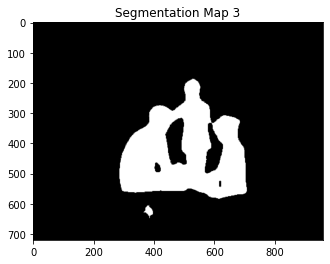

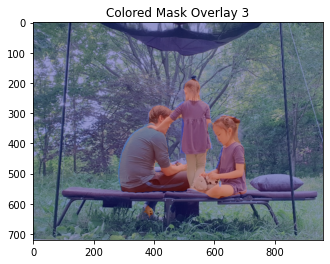

Image 3 uses kernel size: (25, 25)


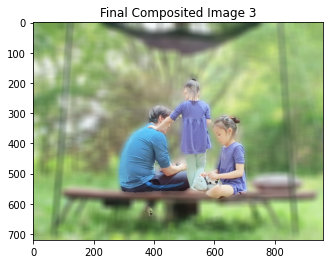

Segmentation map 4 shape: (6720, 4480)


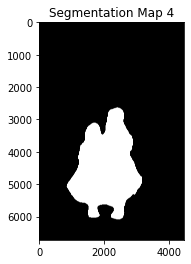

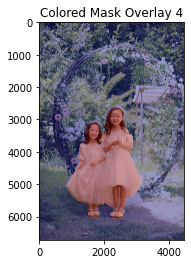

Image 4 uses kernel size: (149, 149)


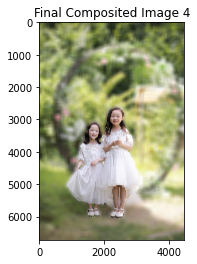

In [29]:
# 각 이미지에 대해 시맨틱 세그멘테이션 수행 및 결과 출력
final_composited_images = []
for i, img_orig in enumerate(images):
    # 모델을 사용하여 이미지 분할 수행
    segvalues, output = model.segmentAsPascalvoc(image_paths[i])

    # 색상 코드 설정 및 세그멘테이션 맵 생성
    seg_color = (128, 128, 192)  # 색상순서 변경 - colormap의 배열은 RGB 순이며 output의 배열은 BGR 순서로 채널 배치가 되어 있어서
    seg_map = np.all(output == seg_color, axis=-1)
    print(f'Segmentation map {i+1} shape: {seg_map.shape}')
    plt.imshow(seg_map, cmap='gray')
    plt.title(f'Segmentation Map {i+1}')
    plt.show()

    # 원본 이미지를 이용하여 사람 위치와 배경을 분리하여 출력
    img_show = img_orig.copy()
    img_mask = seg_map.astype(np.uint8) * 255
    color_mask = cv2.applyColorMap(img_mask, cv2.COLORMAP_JET)
    img_show = cv2.addWeighted(img_show, 0.6, color_mask, 0.4, 0.0)
    plt.imshow(cv2.cvtColor(img_show, cv2.COLOR_BGR2RGB))
    plt.title(f'Colored Mask Overlay {i+1}')
    plt.show()

    # 배경과 사람 분리 및 합성 이미지 출력
    img_mask_color = cv2.cvtColor(img_mask, cv2.COLOR_GRAY2BGR)
    img_bg_mask = cv2.bitwise_not(img_mask_color)
    # 커널 사이즈 동적으로 계산 (이미지 크기에 비례하여 설정)
    kernel_size = max(15, int(min(img_orig.shape[0], img_orig.shape[1]) / 30))
    if kernel_size % 2 == 0:
        kernel_size += 1  # 커널 크기는 홀수여야 함
    print(f'Image {i+1} uses kernel size: ({kernel_size}, {kernel_size})')
    img_bg_blur = cv2.bitwise_and(cv2.blur(img_orig, (kernel_size, kernel_size)), img_bg_mask)
    img_concat = np.where(img_mask_color == 255, img_orig, img_bg_blur)
    final_composited_images.append(img_concat)
    plt.imshow(cv2.cvtColor(img_concat, cv2.COLOR_BGR2RGB))
    plt.title(f'Final Composited Image {i+1}')
    plt.show()

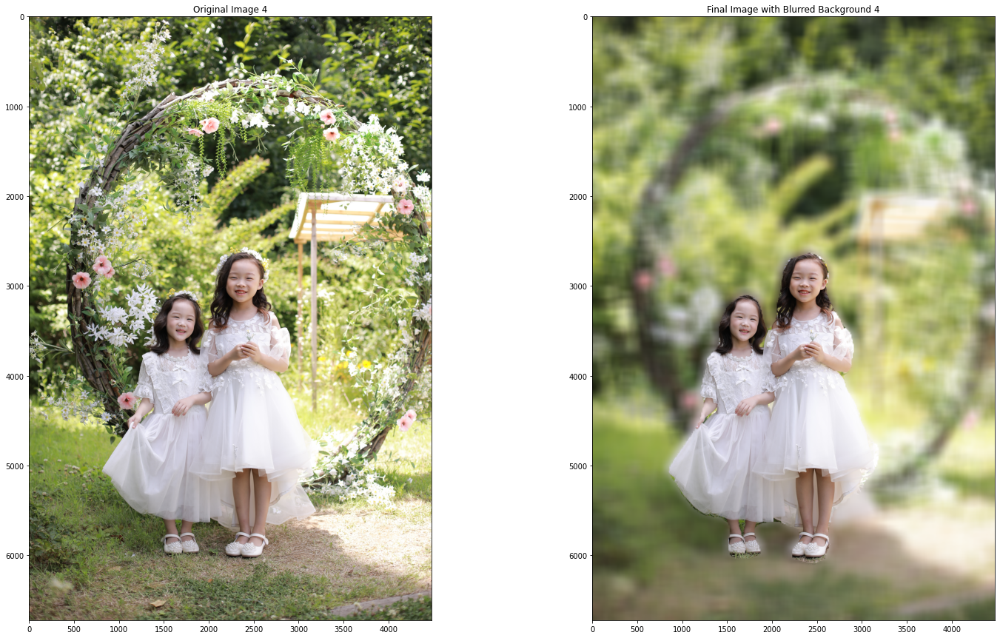

In [30]:
# 최종 합성된 이미지 다시 출력
plt.figure(figsize=(25, 15))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img_orig4, cv2.COLOR_BGR2RGB))
plt.title(f'Original Image 4')
plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(final_composited_images[3], cv2.COLOR_BGR2RGB))
plt.title(f'Final Image with Blurred Background 4')
plt.show()

### 고해상도 image4 에서 커널 사이즈(149, 149) 에서 블러가 효과 확실히 나타남을 확인